# Predicting Drug Perturbations from Cellular Morphology

## Overview
This project explores whether single-cell morphology can be used to predict drug treatments (`Metadata_pert_iname`) using a subset of the JUMP Cell Painting dataset [1]. We segment microscopy images, extract handcrafted features, apply dimensionality reduction, and train a Random Forest classifier to evaluate treatment-specific morphological signals.

## Abstract
High-content imaging enables large-scale analysis of cellular responses to perturbations, offering potential
for drug classification based on cell morphology. In this study, we evaluate whether single-cell morphological
features can be used to predict drug treatments using a subset of a dataset. We segmented 2,867 grayscale
microscopy images using Cellpose, generating over 450,000 individual cell masks. For each cell, we extracted 11
features, capturing size, shape, and intensity descriptors, to name a few. These features were used to train a
Random Forest classifier with and without dimensionality reduction via Principal Component Analysis (PCA).
We evaluated model performance across different input types and sampling strategies, including experiments with
and without the control treatment (DMSO). Accuracy remained low overall, with class imbalance contributing
to overprediction of DMSO despite downsampling. Feature importance analysis highlighted intensity variation
and solidity as modestly informative, and UMAP visualizations revealed weak clustering for treatments. These
findings suggest that while morphological features do reflect some treatment-specific signals, classification is
limited. Our results emphasize the challenge of phenotype-based drug prediction at the single-cell level, while
also demonstrating the capability of interpretable pipelines for large-scale morphological profiling.


---

## 1. Image–Label Mapping

The metadata CSV includes key columns:
- `FileName_OrigRNA`: matches image filenames
- `Metadata_pert_iname`: drug name (prediction target)
- `Metadata_target`: biological target (optional grouping/interpretation)
- `Metadata_cell_line`: cell line used (e.g., A549)
- `Metadata_experiment_type`: experiment type (e.g., "Compound")
- `Metadata_pubchem_cid`: PubChem compound ID

These allow us to:
- Assign groundtruth labels to cell images
- Analyze results by drug, target, or cell line

---

## 2. Data Preprocessing

### 2.1 Implementing Cellpose Algorithm
Adapted from "Cellpose Prediction for 2D v0.5"
- Used Cellpose to download and load the images
  
### 2.2 Segmentation
- Used Cellpose to segment cells in 2867 `.tiff` images
- Saved corresponding masks

### 2.3 Concatenation
- Matched each cell’s features to the drug treatment label of its parent image

---

## 3. Feature Extraction

### 3.1 Morphological Feature Extraction
- Applied a custom feature extraction function using `skimage.measure.regionprops` to each labeled cell region
- Extracted features for each segmented cell, including:
  - Area, eccentricity, perimeter, solidity, mean intensity, orientation, etc.
#### 3.1.1 Using your own dataset?
- Extract the features and treatments from your dataset
#### 3.1.2 Loading provided dataset
- Otherwise, use the data provided here
#### 3.1.4 Cell count mask
- To reduce runtime, we look at the top 20 treatments with the most segmented cell counts

### 3.2 Dimensionality Reduction
- Applied PCA to reduce the 11-dimensional feature space to n principal components
- Helps with:
  - Noise reduction
  - Visualization (ie. UMAP)
  - Speeding up training
#### 3.2.1 Scree plot
- Find the number of principal components that explain 95% of the variance
#### 3.2.2 Elbow method
- Find the optimal number of clusters by finding the point where adding more clusters yields diminishing returns in explained variance
---

## 4. Train a Classifier

### 4.1 Random Forest
- Used for its robustness and interpretability
- Stratified by treatment 80/20 train/test split

#### 4.1.1 All features/treatments
- Ran into RAM issues both with and without PCA

#### 4.1.2 Top 20 features/treatments
- Only searched for the best number of estimators for without PCA and without DMSO
  - Best practice should serach for the best number of estimators for each experiment
- Ran experiments with with and witout PCA
- Ran experiments both with and without DMSO, the control treatment
---

## 5. Evaluate and Visualize
- Accuracy
- Confusion matrix to show common misclassifications
- Random Forest bar plots of feature importances
- UMAP of PCA-reduced features to visualize morphological clustering
  - Silhouette score

## Notes:
download_data.py is fully written by ChatGPT. I wanted to see if I could connect the data from my Google Drive to my GitHub without directly needing to download the files because it is a large zip. However, if the code does not work according to plan, please use this link (https://drive.google.com/file/d/1s7N1JTEgNZ3UrBR2Kc3NPLPyBXZXYssB/view?usp=sharing) to access the zip file. You can only access the file through your LionMail account.

---
## References
1. Chandrasekaran, S. N., Cimini, B. A., Goodale, A., Miller, L., Kost-Alimova, M., Jamali, N., Doench, J. G., et al. (2024). *Three million images and morphological profiles of cells treated with matched chemical and genetic perturbations*. **Nature Methods**, 21(6), 1114–1121. https://doi.org/10.1038/s41592-024-02241-6
2. Image-based Profiling with Cell Painting. 2024. Google Colaboratory notebook. Retrieved March 27, 2025, from https://colab.research.google.com/drive/1SDwTBwiS8qQO3kG4LDqNWxAn-TcUFzJ-#scrollTo=hG3LSmJmLylT


Installing and importing dependencies

In [7]:
!pip install scikit-image

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.4/13.4 MB 6.8 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 315.8/315.8 kB 7.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 5.1 MB/s eta 0:00:0000:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.3/227.3 kB 5.7 MB/s eta 0:00:0000:01
DEPRECATION: pytorch-lightning 1.6.0 has a non-standard dependency specifier torch>=1.8.*. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pytorch-lightning or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063


In [ ]:
!pip install imagecodecs
!pip install umap-learn
!pip install seaborn
!pip install tensorflow

DEPRECATION: pytorch-lightning 1.6.0 has a non-standard dependency specifier torch>=1.8.*. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pytorch-lightning or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063
DEPRECATION: pytorch-lightning 1.6.0 has a non-standard dependency specifier torch>=1.8.*. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pytorch-lightning or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063
DEPRECATION: pytorch-lightning 1.6.0 has a non-standard dependency specifier torch>=1.8.*. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of pytorch-lightning or contact the author

In [ ]:
import os, sys, time, random
import shutil
from urllib.parse import urlparse

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300

from skimage import io, color, measure

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import (accuracy_score, classification_report,
                             confusion_matrix, silhouette_score, silhouette_samples)
from sklearn.utils import resample
from sklearn.cluster import KMeans

import tensorflow as tf
import umap 
import matplotlib.patches as mpatches

np.random.seed(1)
random.seed(1)
tf.random.set_seed(1)

# 1. Image-Label Mapping

Loading CSV file

In [ ]:
df = pd.read_csv(os.path.join(os.getcwd(),'data','cellmorph','metadata_BR00116991.csv'))

df = df.drop(['Unnamed: 0', 'Metadata_ChannelID', 'Metadata_Plate'], axis=1)
df['Image_Name'] = df.FileName_OrigRNA.apply(lambda x: x[:9])

df

,FileName_OrigRNA,Metadata_Well,Metadata_Site,Metadata_AbsPositionZ,Metadata_PositionX,Metadata_PositionY,Metadata_PositionZ,Metadata_Row,Metadata_target,Metadata_experiment_type,Metadata_cell_line,Metadata_pert_iname,Metadata_gene,Metadata_pubchem_cid,Image_Name
0,r01c01f01p01-ch3sk1fk1fl1.tiff,A01,1,0.134679,-0.000323,0.000323,-0.000002,1,CACNB4,Compound,A549,gabapentin-enacarbil,NaN,9883933.0,r01c01f01
1,r01c01f02p01-ch3sk1fk1fl1.tiff,A01,2,0.134679,-0.000969,0.000969,-0.000002,1,CACNB4,Compound,A549,gabapentin-enacarbil,NaN,9883933.0,r01c01f02
2,r01c01f03p01-ch3sk1fk1fl1.tiff,A01,3,0.134673,0.000323,0.000969,-0.000002,1,CACNB4,Compound,A549,gabapentin-enacarbil,NaN,9883933.0,r01c01f03
3,r01c01f04p01-ch3sk1fk1fl1.tiff,A01,4,0.134674,0.000969,0.000323,-0.000002,1,CACNB4,Compound,A549,gabapentin-enacarbil,NaN,9883933.0,r01c01f04
4,r01c01f05p01-ch3sk1fk1fl1.tiff,A01,5,0.134681,-0.000969,-0.000323,-0.000002,1,CACNB4,Compound,A549,gabapentin-enacarbil,NaN,9883933.0,r01c01f05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3451,r16c24f05p01-ch3sk1fk1fl1.tiff,P24,5,0.134302,-0.000969,-0.000323,-0.000002,16,HTR3A,Compound,A549,aripiprazole,NaN,60795.0,r16c24f05
3452,r16c24f06p01-ch3sk1fk1fl1.tiff,P24,6,0.134302,0.000323,-0.000323,-0.000002,16,HTR3A,Compound,A549,aripiprazole,NaN,60795.0,r16c24f06
3453,r16c24f07p01-ch3sk1fk1fl1.tiff,P24,7,0.134300,0.000969,-0.000969,-0.000002,16,HTR3A,Compound,A549,aripiprazole,NaN,60795.0,r16c24f07
3454,r16c24f08p01-ch3sk1fk1fl1.tiff,P24,8,0.134300,-0.000323,-0.000969,-0.000002,16,HTR3A,Compound,A549,aripiprazole,NaN,60795.0,r16c24f08


# 2. Data Preprocessing
In this section, we completely follow the Cellpose algorithm adapted from: [Image-based Profiling with Cell Painting - Colab Notebook](https://colab.research.google.com/drive/1SDwTBwiS8qQO3kG4LDqNWxAn-TcUFzJ-). This allows us to properly preprocess and segment the data.

## 2.1 Implementing Cellpose Algorithm



In [ ]:
#@markdown ##Step 2: Click Play to Install Cellpose
#@markdown **PLEASE WAIT FOR THIS CELL TO COMPLETE AND YOUR RUN TIME TO RESTART BEFORE CONTINUING TO STEP 3**
#@markdown * After cellpose installation, the runtime will restart a warning that it has **crashed**, which is fine. This is essential to configure the environment.

#@markdown * On occasion, you may not be able to see the folders on the left panel. Just refresh your browser webpage and it should appear.
#!pip install git+https://www.github.com/mouseland/cellpose.git #to install development version
!pip install "cellpose==2.3.2"
!pip install torch torchvision torchaudio
!pip install omnipose

# To fix mismatch error in step 3
!pip uninstall -y numpy
!pip install numpy==1.23.5 --no-cache-dir

#Fix opencv error: ImportError: cannot import name '_registerMatType' from 'cv2.cv2'
!pip install "opencv-python-headless<4.3"
exit(0) #Restart Runtime to use newly installed numpy
#or may get the error: ValueError: numpy.ndarray size changed, may indicate binary incompatibility. Expected 88 from C header, got 80 from PyObject

#https://stackoverflow.com/questions/8924173/how-do-i-print-bold-text-in-python
BOLD = '\033[1m'
UNDERLINE = '\033[4m'
END = '\033[0m'



print("\n"+BOLD+UNDERLINE+"Restarting the RUNTIME. Wait till you see the green tick on the right top, next to RAM and Disk before proceeding."+END)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.9/176.9 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 49.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 55.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 56.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 40.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 91.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 95.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 MB 41.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albucore 0.0.23 requires numpy>=1.24.4, but you have numpy 1.23.5 which is incompatible.
albucore 0.0.23 requires opencv-python-headless>=4.9.0.80, but you have opencv-python-headless 3.4.18.65 which is incompatible.
albumentations 2.0.5 requires numpy>=1.24.4, but you have numpy 1.23.5 which is incompatible.
albumentations 2.0.5 requires opencv-python-headless>=4.9.0.80, but you have opencv-python-headless 3.4.18.65 which is incompatible.

Restarting the RUNTIME. Wait till you see the green tick on the right top

In [ ]:
#@markdown ##Step 3: Once **Step 2 is completed**, run this cell to configure Cellpose, dependencies and check GPU access
#@markdown

#@markdown *Models will be downloaded when running for the first time*
#disabled installation and import of mxnet as pytorch is the default neural net
import numpy as np
import time, os, sys, random
from urllib.parse import urlparse
import skimage.io
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300

from urllib.parse import urlparse
import shutil

#from tifffile import imread, imsave


print ("Downloading Models")
from cellpose import models,core

model_list = models.MODEL_NAMES

#Enable Logging
from cellpose.io import logger_setup
logger_setup()

#https://stackoverflow.com/questions/8924173/how-do-i-print-bold-text-in-python
BOLD = '\033[1m'
UNDERLINE = '\033[4m'
END = '\033[0m'

#Check if colab notebook instance has GPU access
if core.use_gpu()==False:
  #Warnings from the ZeroCost StarDist notebook
  print(BOLD+UNDERLINE+'You do not have GPU access.'+END)
  print('Did you change your runtime ?')
  print('If the runtime setting is correct then Google did not allocate a GPU for your session')
  print('Expect slow performance. To access GPU try reconnecting later')
  use_GPU=False
else:
  print(BOLD+UNDERLINE+"You have access to the GPU."+END+"\nDetails are:")
  print("*************************************************")
  !nvidia-smi
  use_GPU=True

print("*************************************************")
print("Libraries imported and configured")


creating new log file
You have access to the GPU.
Details are:
*************************************************
Tue Mar 25 19:39:25 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   33C    P0             19W /   70W |     104MiB /  15360MiB |      3%      Default |
|                          

In [ ]:
#@markdown Put the location of the data in the following line:
dataloc = os.path.join(os.getcwd(),"data", "cellmorph", 'lmb_downsampled_data') #@param {type:"string"}

image_format = "tiff"

input_dir = os.path.join(dataloc, "") #adds separator to the end regardless if path has it or not

# r=root, d=directories, f = files
files=[]

for r, d, f in os.walk(input_dir):
    for fil in f:
      if (image_format):
        if fil.endswith(image_format):
          files.append(os.path.join(r, fil))
      else:
        files.append(os.path.join(r, fil))
    break #only read the root directory; can change this to include levels
if(len(files)==0):
  print("Number of images loaded: %d." %(len(files)))
  print("Cannot read image files. Check if folder has images")
else:
  print("Number of images loaded: %d." %(len(files)))


save_dir = dataloc+"/Masks/"
if not os.path.exists(save_dir):
  os.makedirs(save_dir)
else:
  print("Existing Mask Directory found. Deleting it.")
  shutil.rmtree(save_dir)

#@markdown ### Step 3: Generating a save directory for the masks.
#@markdown ##### Save Directory will be created in the input path under Masks

Number of images loaded: 2867.
Existing Mask Directory found. Deleting it.


In [ ]:
#@markdown ###Step 4: Read and Load all the images
#@markdown #####A random image will be shown as an example with each channel separated. If it is a single channel image, only the one channel will be shown
#imgs = [imread(f) for f in files]

imgs=[] #store all images
#Read images
for f in files:
  im=skimage.io.imread(f)
  n_dim=len(im.shape) #shape of image
  dim=im.shape #dimensions of image
  channel=min(dim) #channel will be dimension with min value usually
  channel_position=dim.index(channel)
  #if no of dim is 3 and channel is first index, swap channel to last index
  if n_dim==3 and channel_position==0:
    #print(dim)
    im=im.transpose(1,2,0)
    dim=im.shape
    #print("Shape changed")
  imgs.append(im)

nimg = len(imgs)
print("No. of images loaded are: ", nimg)

No. of images loaded are:  2867


## 2.2 Segmentation

In section, we define:

*   Channels for segmentation
*   Cellpose Parameters:
    * Diameter
    * Flow Threshold
    * Cell Probability Threshold

More info on Models: https://cellpose.readthedocs.io/en/latest/models.html

#### As a general rule of thumb, segmentation of a cell using a membrane/cytoplasm dye is more accurate when used in combination with a nuclei marker.


In [5]:
#@markdown #### **STEP 5**.  RUN THIS CELL and select cyto2, the model we will use for segmentation
import ipywidgets as widgets
from IPython.display import display

model_choices = widgets.Dropdown(
    options=model_list,
    value='cyto2',
    description='Model Choice:',
    disabled=False,
)

def on_change(model_change):
  print("Model changed to :",model_change.new)
print("Choose MODEL from this list before proceeeding. Default is cyto2:")
model_choices.observe(on_change,names = 'value')

display(model_choices)

Choose MODEL from this list before proceeeding. Default is cyto2:


Dropdown(description='Model Choice:', index=4, options=('cyto', 'nuclei', 'tissuenet', 'livecell', 'cyto2', 'g…

In [6]:
#@markdown #### **STEP 6**.  Run this cell to define the channels to use for segmentation

model_type= model_choices.value
print("Using model ",model_type)

Channel_for_segmentation="0"
segment_channel=int(Channel_for_segmentation)


Use_nuclear_channel= False
Nuclear_channel="3"
nuclear_channel=int(Nuclear_channel)



#disabling omnipose for now as the flag has been removed from CELLPOSE
#omni= False #@param {type:"boolean"}


Diameter =  0#
diameter=Diameter

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
# channels = [0,0] # IF YOU HAVE GRAYSCALE
# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus


#if model_choice=="Cytoplasm":
#  model_type="cyto"

##elif model_choice=="Cytoplasm2":
##  model_type="cyto2"

#elif model_choice=="Cytoplasm2_Omnipose":
#  model_type="cyto2_omni"

#elif model_choice=="Bacteria_Omnipose":
#  model_type="bact_omni"
#  diameter = 0

#elif model_choice=="Nuclei":
#  model_type="nuclei"


# channels = [cytoplasm, nucleus]
if model_type != "nuclei":
  if Use_nuclear_channel:
    channels=[segment_channel,nuclear_channel]
  else:
    channels=[segment_channel,0]
else: #nucleus
  channels=[segment_channel,0]




# DEFINE CELLPOSE MODEL
# model_type='cyto' or model_type='nuclei'
model = models.CellposeModel(gpu=use_GPU, model_type=model_type, net_avg = True)#, omni = omni

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
# channels = [0,0] # IF YOU HAVE GRAYSCALE
# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus

# or if you have different types of channels in each image
#channels = [[2,3], [0,0], [0,0]]

# if diameter is set to None, the size of the cells is estimated on a per image basis
# you can set the average cell `diameter` in pixels yourself (recommended)
# diameter can be a list or a single number for all images
if diameter == 0:
  diameter = None
  print("Diameter is set to None. The size of the cells will be estimated on a per image basis")

Using model  cyto2


100%|██████████| 25.3M/25.3M [00:01<00:00, 24.3MB/s]
100%|██████████| 25.3M/25.3M [00:01<00:00, 23.9MB/s]
100%|██████████| 25.3M/25.3M [00:01<00:00, 22.0MB/s]
100%|██████████| 25.3M/25.3M [00:01<00:00, 22.6MB/s]


Diameter is set to None. The size of the cells will be estimated on a per image basis


**Step 6.1: Test cellpose on an image. You can tune the parameters below based on your image**

The cell below gives you an opportunity to test different parameters and figure out the right combination that gives your output of interest

The ***Flow_threshold parameter*** is  the  maximum  allowed  error  of  the  flows  for  each  mask.   The  default  is 0.4.

*   **Increase** this threshold if cellpose is not returning as many masks as you’d expect

*   **Decrease** this threshold if cellpose is returning too many ill-shaped masks.

The ***Cell Probability Threshold*** determines proability that a detected object is a cell.   The  default  is 0.0.

*   **Decrease** this threshold if cellpose is not returning as many masks as you’d expect or if masks are too small

*   **Increase** this threshold if cellpose is returning too many masks esp from dull/dim areas.

If you do not know **diameter** of the cells OR if cells are of varying diameters, enter 0 in the Diameter box and cellpose will automatically estimate the diameter

For more information on the parameters: https://cellpose.readthedocs.io/_/downloads/en/latest/pdf/

Image: r01c20f02_median_aggregated


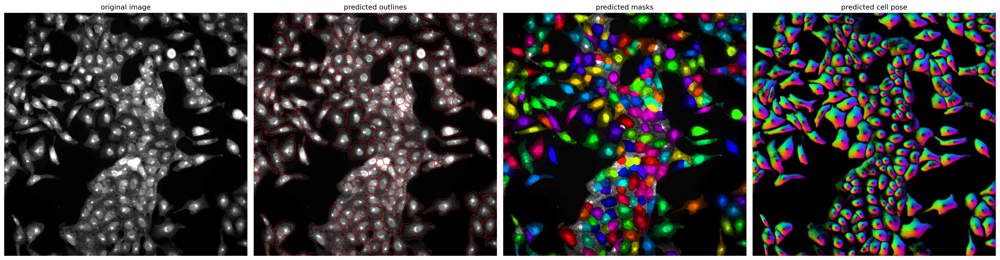

In [7]:
from skimage.util import img_as_ubyte
#@markdown You can change this number to select a different image to test cellpose on the image. We have selected the flow threshold parameter=0.7 and cell probability threshold=-5 as listed in our report.
Image_Number =  6#@param {type:"number"}
Image_Number-=1 #indexing starts at zero
#print(Image_Number)
Diameter = 0
#Flow_Threshold=0.4#@param {type:"number"}
Flow_Threshold = 0.7
flow_threshold=Flow_Threshold

#Cell_Probability_Threshold=-5#@param {type:"number"}
#Using slider to restrict values
Cell_Probability_Threshold=-5
cellprob_threshold=Cell_Probability_Threshold


diameter=Diameter
if diameter == 0:
  diameter = None
if Image_Number == -1:
  Image_Number=0
  #print("Image_Number is set to zero, opening first image.")
try:
    image = imgs[Image_Number]
except IndexError as i:
   print("Image number does not exist",i)
   print("Actual no of images in folder: ",len(imgs))
print("Image: %s" %(os.path.splitext(os.path.basename(files[Image_Number]))[0]))
img1=imgs[Image_Number]

import cv2

masks, flows, styles = model.eval(img1, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)
#masks, flows, styles, diams = model.eval(img1, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)



# DISPLAY RESULTS
from cellpose import plot
maski = masks
flowi = flows[0]

#convert to 8-bit if not so it can display properly in the graph
if img1.dtype!='uint8':
  img1=img_as_ubyte(img1)

fig = plt.figure(figsize=(24,8))
#if len(img1.shape)==3:
  #img_ch_plot = img1[:,:,segment_channel]img_ch_plot
plot.show_segmentation(fig, img1 , maski, flowi, channels=channels)
plt.tight_layout()
plt.show()



---
**USE CELLPOSE TO SEGMENT CELLS**
The values defined above will be used for segmentation.

The masks will be saved automatically.

Saving the flow image/s are optional. Tick if you want to save them.



In [ ]:
#@markdown ### **Step 7. Run Cellpose on folder of images**

#@markdown ###Tick if you want to save the flow image/s:
Save_Flow= True #@param {type:"boolean"}
#@markdown ##### *Flow image will be resized when saved
save_flow=Save_Flow

print("Running segmentation on channel %s" %(segment_channel))
print("Using the model: ",model_type)
if diameter is None:
  print("Diameter will be estimated from the image/s")
else:
  print(f"Cellpose will use a diameter of {diameter}")

print(f"Using a flow threshold of: {flow_threshold} and a cell probability threshold of: {cellprob_threshold}")

#if too many images, it will lead to memory error.
#will evaluate on a per image basis
#masks, flows, styles, diams = model.eval(imgs, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)


#save images in folder with the diameter value used in cellpose
print("Segmentation Done. Saving Masks and flows now")
print("Save Directory is: ",save_dir)
if (not os.path.exists(save_dir)):
    os.mkdir(save_dir)

if save_flow:
  print("Saving Flow")
  flows_save_dir=save_dir+"flows"+os.sep
  print("Save Directory for flows is: ",flows_save_dir)
  if (not os.path.exists(flows_save_dir)):
      os.mkdir(flows_save_dir)


for img_idx, img in enumerate(imgs):
    file_name=os.path.splitext(os.path.basename(files[img_idx]))[0]
    print("\nSegmenting: ",file_name)
    #mask, flow, style, diam = model.eval(img, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)
    mask, flow, style = model.eval(img, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)
    #save images in folder with the diameter value used in cellpose
    print("Segmentation complete . Saving Masks and flows")
    #Output name for masks
    mask_output_name=save_dir+"MASK_"+file_name+".tiff"
    #Save mask as 16-bit in case this has to be used for detecting than 255 objects
    mask=mask.astype(np.uint16)
    #Save flow as 8-bit
    skimage.io.imsave(mask_output_name,mask, check_contrast=False)
    if save_flow:
      #Output name for flows
      flow_output_name=flows_save_dir+"FLOWS_"+file_name+".tiff"
      #Save as 8-bit
      flow_image=flow[0].astype(np.uint8)
      skimage.io.imsave(flow_output_name,flow_image, check_contrast=False)

#Save parameters used in Cellpose
parameters_file=save_dir+"Cellpose_parameters_used.txt"
outFile=open(parameters_file, "w")
outFile.write("CELLPOSE PARAMETERS\n")
outFile.write("Model: "+model_type+"\n")
if diameter == 0:
  diameter = "Automatically estimated by cellpose"
#outFile.write("Omni Flag: "+str(omni)+"\n")
outFile.write("Diameter: "+str(diameter)+"\n")
outFile.write("Flow Threshold: "+str(flow_threshold)+"\n")
outFile.write("Cell probability Threshold: "+str(cellprob_threshold)+"\n")
outFile.close()
print("\nSegmentation complete and files saved")

Streaming output truncated to the last 5000 lines.

Segmenting:  r03c17f08_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r02c21f06_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r02c12f05_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r07c18f01_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r11c16f05_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r02c22f01_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r01c04f06_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r05c06f07_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r05c05f09_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r02c11f02_median_aggregated
Segmentation complete . Saving Masks and flows

Segmenting:  r10c20f02_median_aggregated
Segmentation comp

## 2.3 Concatenation
If you are not using our provided dataset, continue and call

In [5]:
# Now, we need to concatenate the images and masks together.
image_files = os.listdir(dataloc)
mask_files = os.listdir(save_dir)

# Getting file names
filenames = df['Metadata_pert_iname'].tolist()
metadata_dict = df.set_index("Image_Name").to_dict('index')
mask_dict = {mask_file[5:14]: mask_file for mask_file in mask_files}

In [44]:
images = []
masks = []
treatment_labels = []

for image_file in image_files:
    key = image_file[:9]

    if key not in metadata_dict:
        continue

    image_path = os.path.join(dataloc, image_file)
    img = io.imread(image_path)

    # Look up the mask quickly using the dictionary
    mask_file = mask_dict.get(key)
    if mask_file is None:
        continue
    mask_path = os.path.join(save_dir, mask_file)
    mask_img = io.imread(mask_path)

    # Retrieve the treatment label from the metadata
    treatment = metadata_dict[key].get('Metadata_pert_iname', 'unknown')

    # Add images
    images.append(img)
    masks.append(mask_img)
    treatment_labels.append(treatment)

print(f"Sanity check -- Total number of images: {len(images)}")
print(f"Number of unique treatments: {len(set(treatment_labels))}")

# 3. Feature Extraction

## 3.1 Morphological Feature Extraction

In [6]:
def extract_enhanced_features(image, mask):
    regions = measure.regionprops(mask, intensity_image=image)
    features = []
    for region in regions:
        features.append([
            region.area,
            region.perimeter,
            region.eccentricity,
            region.mean_intensity,
            region.solidity,
            region.extent,
            region.major_axis_length,
            region.minor_axis_length,
            region.orientation,
            region.perimeter_crofton,
            np.std(region.intensity_image),
        ])
    return np.array(features)

### 3.1.1 Using your own dataset?

In [16]:
all_features = []
all_treatments = []

for img, mask, treatment in zip(images, masks, treatment_labels):
    if img.ndim == 3:
        img_gray = color.rgb2gray(img)
    else:
        img_gray = img
    feats = extract_enhanced_features(img_gray, mask)
    if feats.size == 0:
        print(f"No cell features extracted from one image; skipping it.")
        continue
    all_features.append(feats)
    all_treatments.extend([treatment] * feats.shape[0])

if len(all_features) == 0:
    raise ValueError("No features extracted from any image/mask pair.")

all_features = np.vstack(all_features)
all_treatments = np.array(all_treatments)

### 3.1.2 Loading provided features and treatments

In [ ]:
all_features = os.path.join(os.getcwd(),"data", "cellmorph", "all_features.npy")
all_treatments = os.path.join(os.getcwd(),"data", "cellmorph", "all_treatments.npy")

### 3.1.3 Sanity check for features and treatments
Checking the number of segmented cells for each treatment

In [96]:
unique_treatments, counts = np.unique(all_treatments, return_counts=True)
for treatment, count in zip(unique_treatments, counts):
    print(f"Treatment: {treatment}, Data Points: {count}")

Treatment: 1-octanol, Data Points: 1347
Treatment: 2,5-furandimethanol, Data Points: 1408
Treatment: 2-Oleoylglycerol, Data Points: 1800
Treatment: 4-CMTB, Data Points: 2101
Treatment: 4-methylhistamine, Data Points: 2150
Treatment: 7-hydroxystaurosporine, Data Points: 947
Treatment: A205804, Data Points: 1790
Treatment: AC-710, Data Points: 1420
Treatment: AK-7, Data Points: 1418
Treatment: ANR-94, Data Points: 1402
Treatment: AR-12, Data Points: 362
Treatment: AVL-292, Data Points: 756
Treatment: AZ191, Data Points: 927
Treatment: AZD7762, Data Points: 953
Treatment: AZD9668, Data Points: 1537
Treatment: BAM7, Data Points: 1701
Treatment: BAN-ORL-24, Data Points: 930
Treatment: BAX-channel-blocker, Data Points: 868
Treatment: BAY-87-2243, Data Points: 1426
Treatment: BI-2536, Data Points: 1075
Treatment: BMS-536924, Data Points: 645
Treatment: BQ-788, Data Points: 1735
Treatment: BRL-50481, Data Points: 1536
Treatment: BVT-948, Data Points: 1452
Treatment: CC-401, Data Points: 1930
T

### 3.1.4 Cell count mask

In [22]:
# Scaling the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(all_features)

In [23]:
# Transforming the numpy file into a series object
all_treatments_series = pd.Series(all_treatments)

# Creating a mask of the not control group (DMSO)
non_dmso_mask = ~(all_treatments_series.str.upper() == 'DMSO')

# Applying said mask to the features and treatments
features_no_dmso = features_scaled[non_dmso_mask]
treatments_no_dmso = all_treatments[non_dmso_mask]

In [24]:
# Ordering the treatment counts without DMSO and selecting the top 20
treatment_counts = pd.Series(all_treatments)[pd.Series(all_treatments).str.upper() != 'DMSO'].value_counts()
top_20_treatments = treatment_counts.head(20)

print("Top 20 non-DMSO treatments by sample count:")
for treatment, count in top_20_treatments.items():
    print(f"{treatment}: {count} samples")

Top 20 non-DMSO treatments by sample count:
FK-866: 3285 samples
lonafarnib: 3013 samples
ZK-93423: 2912 samples
GSK2110183: 2650 samples
thiostrepton: 2566 samples
thioguanine: 2543 samples
nilvadipine: 2351 samples
TFC-007: 2288 samples
azacitidine: 2248 samples
zamifenacin: 2194 samples
rifamycin: 2174 samples
NSC-625987: 2170 samples
4-methylhistamine: 2150 samples
L-proline: 2101 samples
4-CMTB: 2101 samples
YC-1: 2032 samples
olopatadine: 2022 samples
dalfampridine: 2011 samples
SGX523: 2004 samples
sacubitril: 1987 samples


## 3.2 Dimensionality Reduction (PCA)

### 3.2.1 Scree plot

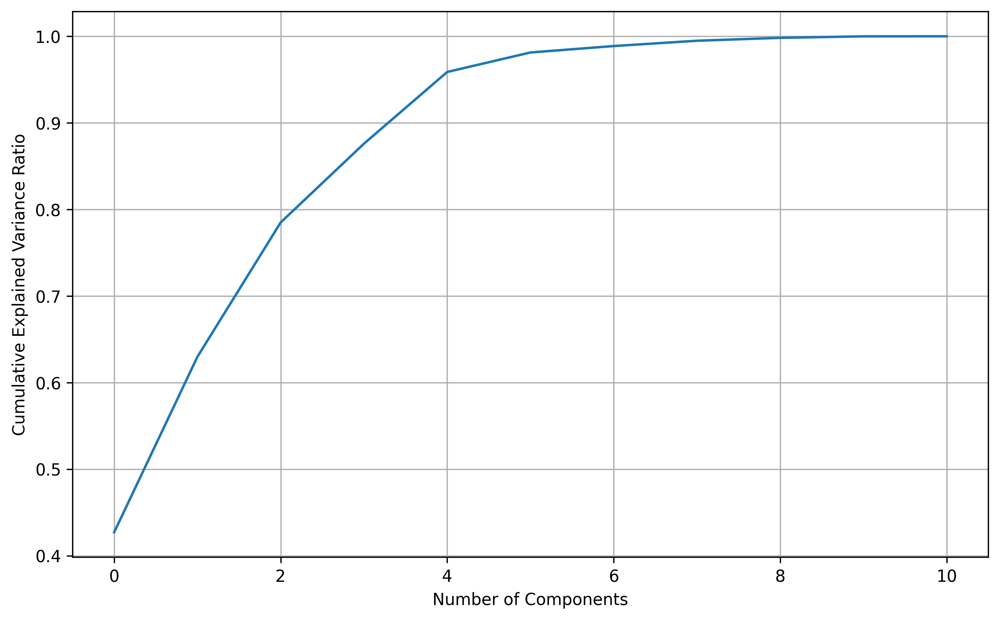

Number of components needed for 95% variance: 5


In [25]:
# Running PCA on all scaled features
pca = PCA()
pca.fit(features_scaled)

# Scree plot
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.grid(True)
plt.show()

n_components = np.where(np.cumsum(pca.explained_variance_ratio_) >= 0.95)[0][0] + 1
print(f"Number of components needed for 95% variance: {n_components}")

### Apply to PCA

In [26]:
# For all scaled features again
pca = PCA(n_components=n_components)
features_pca = pca.fit_transform(features_scaled)

### 3.2.2 Elbow method

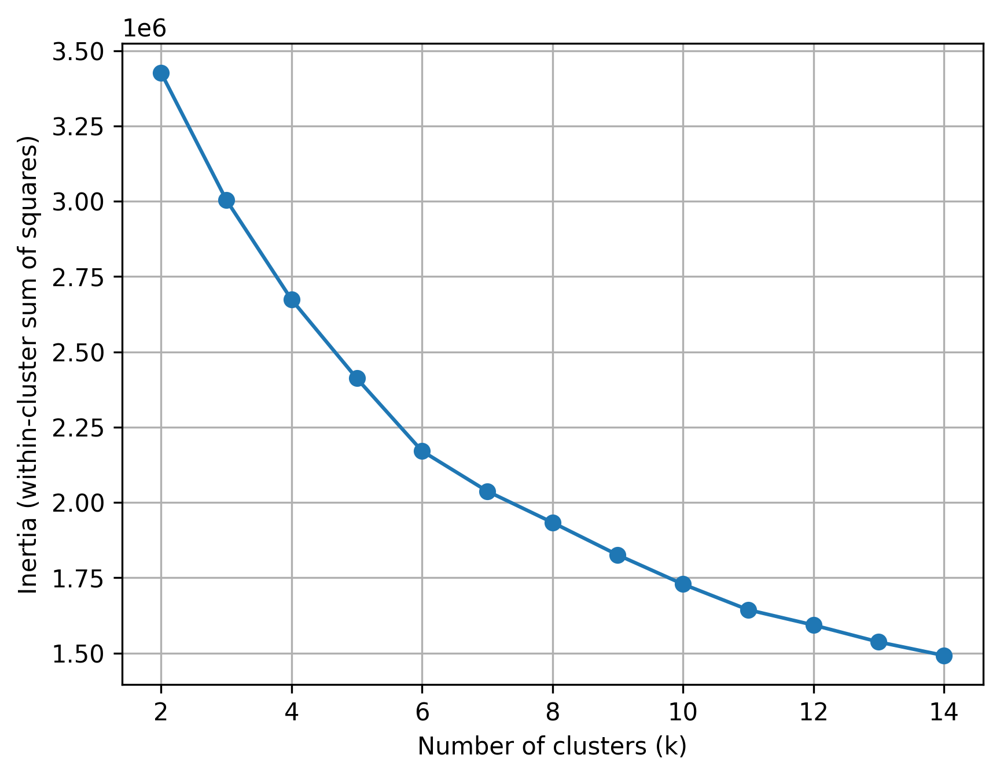

In [15]:
inertia = []
k_range = range(2, 15)

for k in k_range:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(features_pca)
    inertia.append(kmeans.inertia_)

plt.figure()
plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia (within-cluster sum of squares)')
plt.grid(True)
plt.show()


Fitting k means to the data and assigning cluster based on feature similarity

In [11]:
kmeans = KMeans(n_clusters=6)
cluster_assignments = kmeans.fit_predict(features_scaled)

### Plot the first two principal components colored by k means clusters

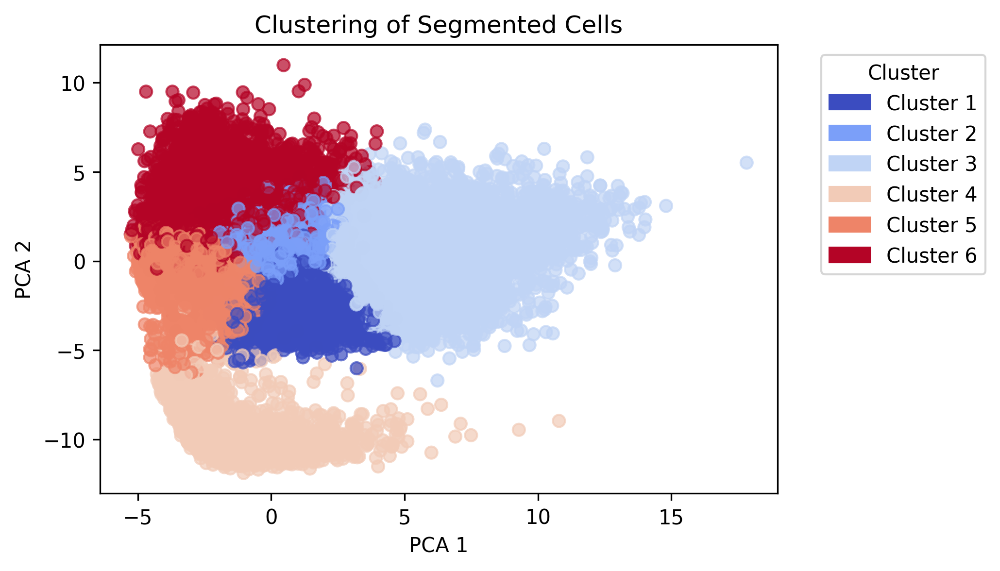

In [13]:
discrete_cmap = plt.get_cmap('coolwarm', kmeans.n_clusters)

plt.figure(figsize=(6, 4))
scatter = plt.scatter(features_pca[:, 0], features_pca[:, 1],
                      c=cluster_assignments, cmap=discrete_cmap, alpha=0.7)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

handles = []
for i in range(kmeans.n_clusters):
    patch = mpatches.Patch(color=discrete_cmap(i), label=f'Cluster {i+1}')
    handles.append(patch)
plt.legend(handles=handles, title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

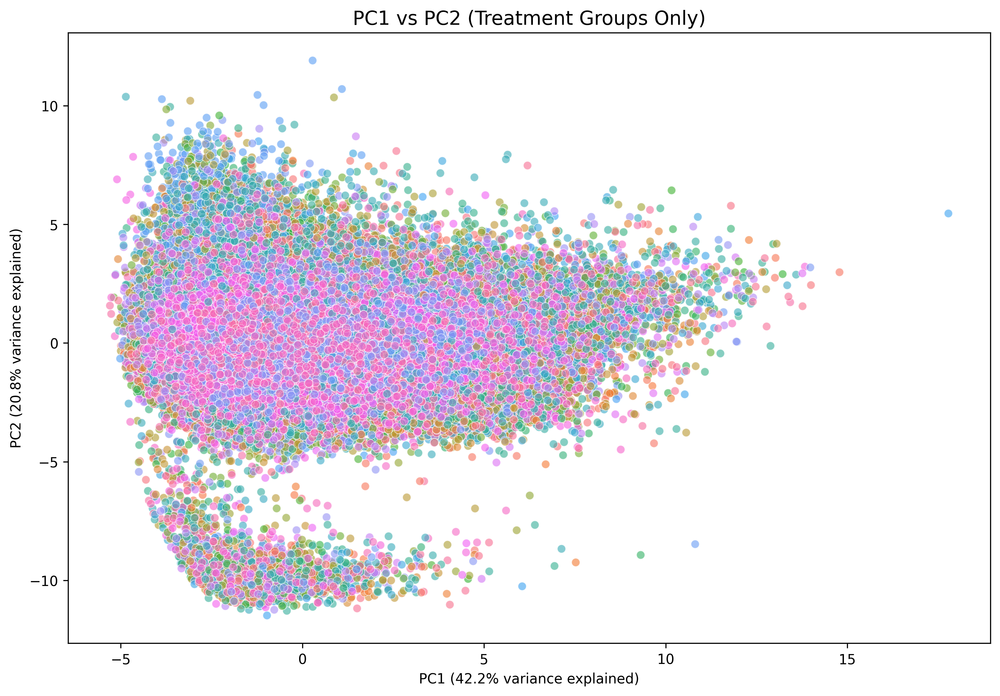


Total variance explained by first 2 PCs: 63.0%


In [109]:
# Plots first two principal components excluding the control group and colored by the different treatment groups

all_treatments_series = pd.Series(all_treatments)

non_dmso_mask = ~(all_treatments_series.str.upper() == 'DMSO')

features_no_dmso = features_scaled[non_dmso_mask]
treatments_no_dmso = all_treatments[non_dmso_mask]

pca_treatments = PCA()
features_pca_treatments = pca_treatments.fit_transform(features_no_dmso)

plt.figure(figsize=(12, 8))
sns.scatterplot(
    x=features_pca_treatments[:, 0],
    y=features_pca_treatments[:, 1],
    hue=treatments_no_dmso,
    alpha=0.6,
    legend=False
)

explained_var_treatments = pca_treatments.explained_variance_ratio_ * 100

plt.title('PC1 vs PC2 (Treatment Groups Only)', fontsize=14)
plt.xlabel(f'PC1 ({explained_var_treatments[0]:.1f}% variance explained)')
plt.ylabel(f'PC2 ({explained_var_treatments[1]:.1f}% variance explained)')

plt.show()

print(f"\nTotal variance explained by first 2 PCs: {sum(explained_var_treatments[:2]):.1f}%")

# 4. Train a Classifier

## 4.1 Random Forest

### 4.1.1 All features/treatments
**WITH PCA >> RAM issues**

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    features_pca, all_treatments, test_size=0.2, stratify=all_treatments
)

clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

**WITHOUT PCA >> RAM issues**

In [ ]:
X_train_prepca, X_test_prepca, y_train_prepca, y_test_prepca = train_test_split(
    all_features, all_treatments, test_size=0.2, stratify=all_treatments
)

clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train_prepca, y_train_prepca)
y_pred_prepca = clf.predict(X_test_prepca)

### 4.1.2 Top 20 features

#### First, search for best number of estimators

In [22]:
estimators = [10, 50, 100, 200, 300]
scores = []

top_20_mask = np.isin(treatments_no_dmso, top_20_treatments.index)

X_top20 = features_no_dmso[top_20_mask]
y_top20 = treatments_no_dmso[top_20_mask]

X_train_20, X_test_20, y_train_20, y_test_20 = train_test_split(
    X_top20, y_top20,
    test_size=0.2,

    stratify=y_top20
)

for n in estimators:
    clf = RandomForestClassifier(n_estimators=n)
    score = cross_val_score(clf, X_train_20, y_train_20, cv=3).mean()
    scores.append(score)

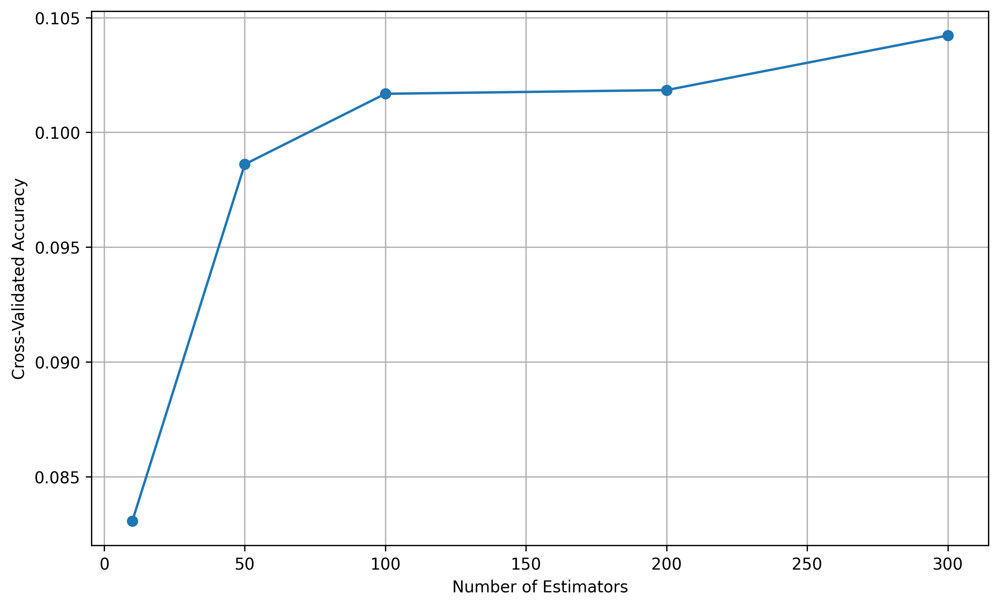

In [25]:
plt.figure(figsize=(10, 6))
plt.plot(estimators, scores, marker='o')
plt.xlabel("Number of Estimators")
plt.ylabel("Cross-Validated Accuracy")
plt.grid(True)
plt.show()

#### Without PCA, with DMSO

In [33]:
top_20_treatments = pd.Series(all_treatments).value_counts().head(20)
top_20_mask = np.isin(all_treatments, top_20_treatments.index)

X_top20 = all_features[top_20_mask]
y_top20 = np.array(all_treatments)[top_20_mask]

X_train_20, X_test_20, y_train_20, y_test_20_DMSO = train_test_split(
    X_top20, y_top20,
    test_size=0.2,

    stratify=y_top20
)

# Combine features and labels into a DataFrame
train_df = pd.DataFrame(X_train_20)
train_df['label'] = y_train_20

# Separate majority (DMSO) and minority classes
majority = train_df[train_df['label'] == 'DMSO']
minority = train_df[train_df['label'] != 'DMSO']

# Downsample majority class
majority_downsampled = resample(
    majority,
    replace=False,
    n_samples=len(minority)
)

# Combine downsampled majority with minority
balanced_df = pd.concat([majority_downsampled, minority])

# Shuffle and split
X_train_balanced = balanced_df.drop('label', axis=1).values
y_train_balanced = balanced_df['label'].values


clf = RandomForestClassifier(n_estimators=100, class_weight='balanced')

clf.fit(X_train_balanced, y_train_balanced)

y_pred_20_DMSO = clf.predict(X_test_20)

#### Without PCA, without DMSO

In [9]:
top_20_mask = np.isin(treatments_no_dmso, top_20_treatments.index)

X_top20 = features_no_dmso[top_20_mask]
y_top20 = treatments_no_dmso[top_20_mask]

X_train_20, X_test_20, y_train_20, y_test_20 = train_test_split(
    X_top20, y_top20,
    test_size=0.2,

    stratify=y_top20
)

clf2 = RandomForestClassifier(n_estimators=100, class_weight='balanced')

clf2.fit(X_train_20, y_train_20)

y_pred_20 = clf2.predict(X_test_20)

#### With PCA, with DMSO

In [16]:
top_20_treatments = pd.Series(all_treatments).value_counts().head(20)
top_20_mask = np.isin(all_treatments, top_20_treatments.index)

X_top20 = all_features[top_20_mask]
y_top20 = np.array(all_treatments)[top_20_mask]

X_train_20, X_test_20, y_train_20, y_test_20pca_DMSO = train_test_split(
    X_top20, y_top20,
    test_size=0.2,

    stratify=y_top20
)

# Combine features and labels into a DataFrame
train_df = pd.DataFrame(X_train_20)
train_df['label'] = y_train_20

# Separate majority (DMSO) and minority classes
majority = train_df[train_df['label'] == 'DMSO']
minority = train_df[train_df['label'] != 'DMSO']

# Downsample majority class
majority_downsampled = resample(
    majority,
    replace=False,
    n_samples=len(minority)
)

# Combine downsampled majority with minority
balanced_df = pd.concat([majority_downsampled, minority])

# Shuffle and split
X_train_balanced = balanced_df.drop('label', axis=1).values
y_train_balanced = balanced_df['label'].values

clf3 = RandomForestClassifier(n_estimators=100, class_weight='balanced')

clf3.fit(X_train_balanced, y_train_balanced)

y_pred_20pca_DMSO = clf3.predict(X_test_20)

#### With PCA, without DMSO

In [14]:
top_20_mask = np.isin(treatments_no_dmso, top_20_treatments.index)

X_top20 = features_no_dmso[top_20_mask]
y_top20 = treatments_no_dmso[top_20_mask]

pca = PCA(n_components=n_components)
pca20 = pca.fit_transform(X_top20)

X_train_20pca, X_test_20pca, y_train_20pca, y_test_20pca = train_test_split(
    pca20, y_top20,
    test_size=0.2,

    stratify=y_top20
)

clf4 = RandomForestClassifier(n_estimators=100, class_weight='balanced')

clf4.fit(X_train_20pca, y_train_20pca)

y_pred_20pca = clf4.predict(X_test_20pca)

# 5. Evaluate and Visualize

#### Accuracy

In [35]:
print("Accuracy RF top 20 with PCA (without DMSO):", accuracy_score(y_test_20pca, y_pred_20pca))
print("Accuracy RF top 20 without PCA (without DMSO):", accuracy_score(y_test_20, y_pred_20))
print("\n")
print("Accuracy RF top 20 with PCA (with DMSO):", accuracy_score(y_test_20pca_DMSO, y_pred_20pca_DMSO))
print("Accuracy RF top 20 without PCA (with DMSO):", accuracy_score(y_test_20_DMSO, y_pred_20_DMSO))

Accuracy RF top 20 with PCA (without DMSO): 0.09249135334151512
Accuracy RF top 20 without PCA (without DMSO): 0.109673100524378


Accuracy RF top 20 with PCA (with DMSO): 0.6782702314731742
Accuracy RF top 20 without PCA (with DMSO): 0.676332316526108


#### Confusion matrix

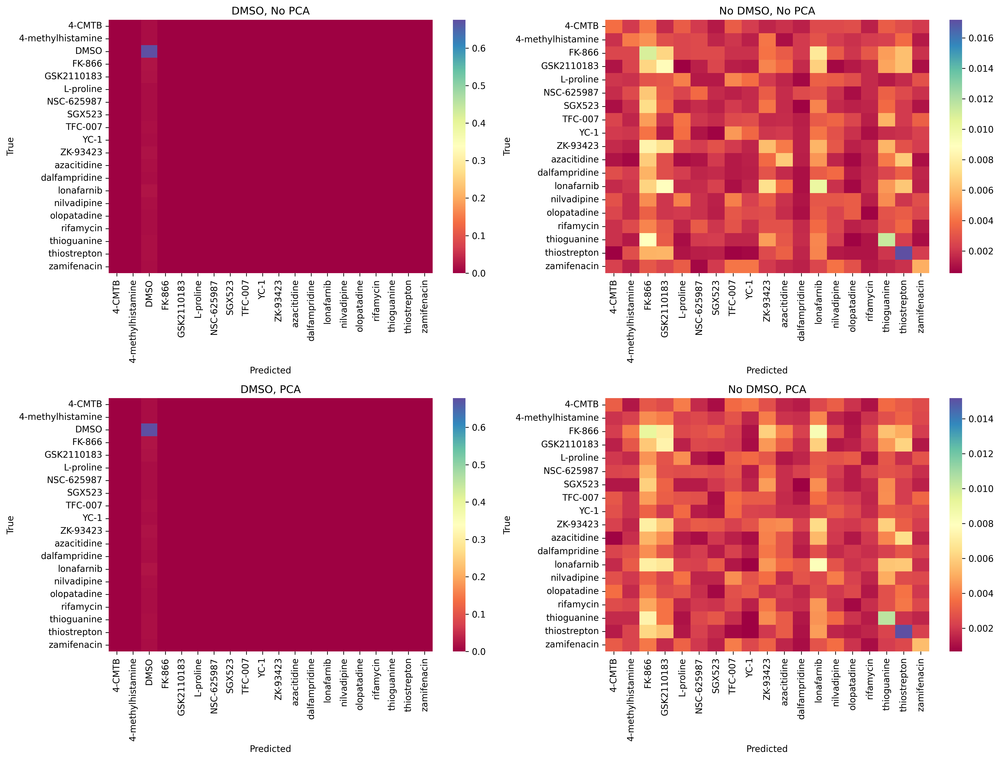

In [73]:
fig, axes = plt.subplots(2, 2, figsize=(16, 12))  # 2 rows, 2 columns

# Example data (you'll replace these with your actual predictions and classifiers)
data = [
    (y_test_20_DMSO, y_pred_20_DMSO, clf, "DMSO, No PCA"),
    (y_test_20, y_pred_20, clf2, "No DMSO, No PCA"),
    (y_test_20pca_DMSO, y_pred_20pca_DMSO, clf3, "DMSO, PCA"),
    (y_test_20pca, y_pred_20pca, clf4, "No DMSO, PCA"),
]

for ax, (y_true, y_pred, clf_model, title) in zip(axes.flat, data):
    cm = confusion_matrix(y_true, y_pred, normalize = 'all')
    sns.heatmap(cm, ax=ax, xticklabels=clf_model.classes_, yticklabels=clf_model.classes_, cmap="coolwarm", annot=False)
    ax.set_title(title)
    ax.set_xlabel("Predicted")
    ax.set_ylabel("True")

plt.tight_layout()
plt.show()

#### Feature Importance

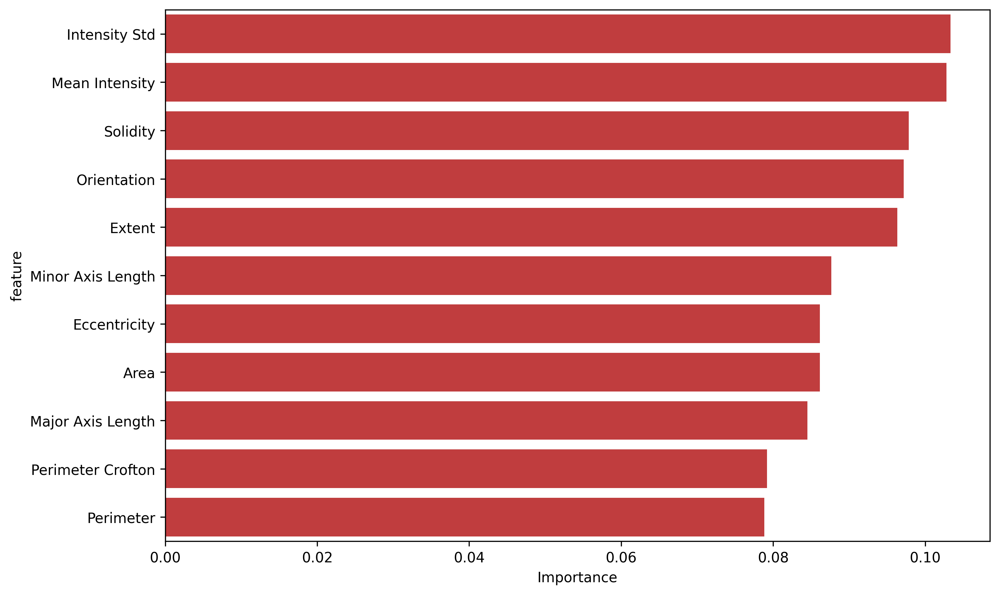

In [10]:
feature_names = [
    "Area", "Perimeter", "Eccentricity", "Mean Intensity",
    "Solidity", "Extent", "Major Axis Length", "Minor Axis Length",
    "Orientation", "Perimeter Crofton", "Intensity Std"
]

feature_importance = pd.DataFrame({
    'feature': feature_names,
    'importance': clf2.feature_importances_
})
feature_importance = feature_importance.sort_values('importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='importance', y='feature', data=feature_importance, color='tab:red')
# plt.title('Feature Importance in Random Forest Model (No PCA, No DMSO)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

#### UMAP

#### Top 20 UMAP with DMSO

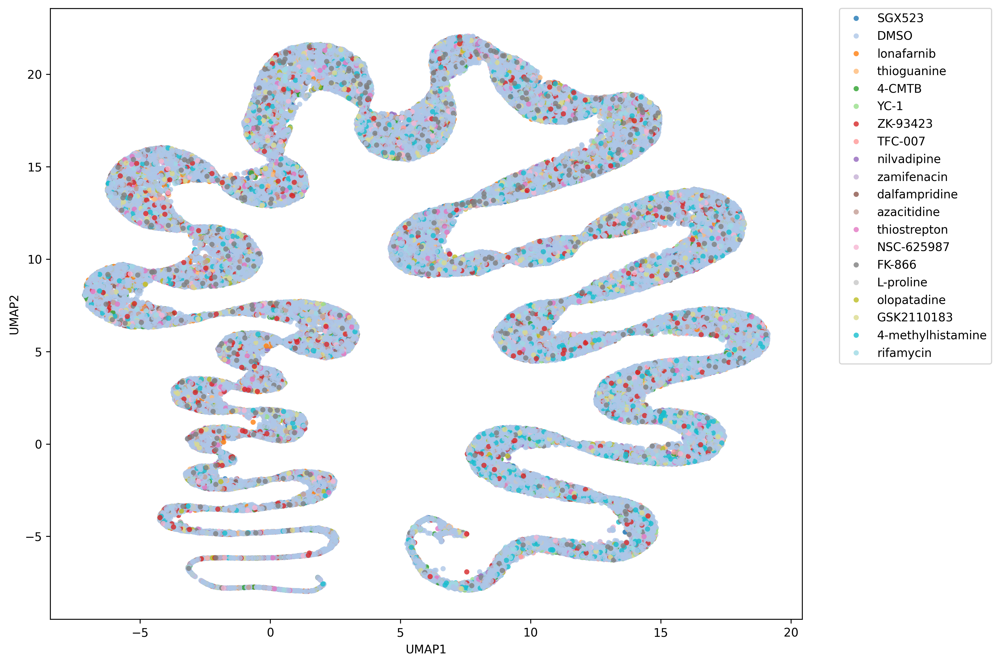

In [49]:
top_20_treatments = pd.Series(all_treatments).value_counts().head(20)
top_20_mask = np.isin(all_treatments, top_20_treatments.index)

X_top20 = all_features[top_20_mask]
y_top20 = np.array(all_treatments)[top_20_mask]

# Initialize UMAP
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1)

# Fit and transform the features
umap_embedding = umap_model.fit_transform(X_top20)

# Turn into a DataFrame for easier plotting
umap_df = pd.DataFrame({
    'UMAP1': umap_embedding[:, 0],
    'UMAP2': umap_embedding[:, 1],
    'Drug': y_top20
})

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=umap_df,
    x='UMAP1', y='UMAP2',
    hue='Drug',
    palette='tab20',
    linewidth=0,
    s=20,
    alpha=0.8,
    legend='full'
)

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.tight_layout()
plt.show()


In [50]:
score = silhouette_score(umap_embedding, y_top20)
print(f"Silhouette Score: {score:.3f}")

Silhouette Score: -0.119


#### Top 20 UMAP without DMSO

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


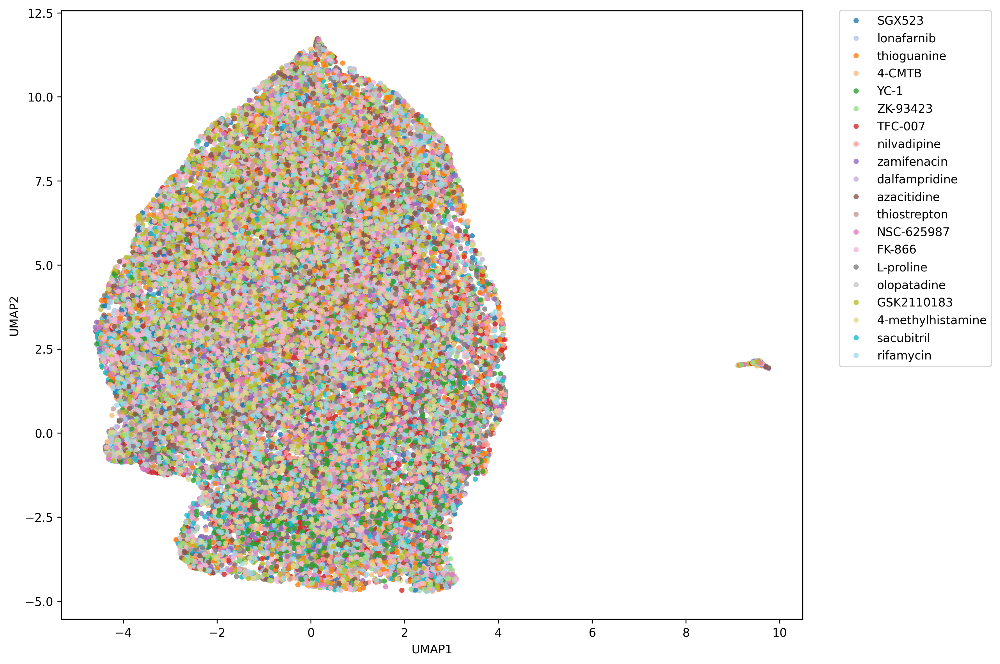

In [36]:
X_top20 = features_no_dmso[top_20_mask]

# Initialize UMAP
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1)

# Fit and transform the features
umap_embedding = umap_model.fit_transform(X_top20)

# Turn into a DataFrame for easier plotting
umap_df = pd.DataFrame({
    'UMAP1': umap_embedding[:, 0],
    'UMAP2': umap_embedding[:, 1],
    'Drug': y_top20
})

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=umap_df,
    x='UMAP1', y='UMAP2',
    hue='Drug',
    palette='tab20',
    linewidth=0,
    s=20,
    alpha=0.8,
    legend='full'
)

# plt.title("UMAP Projection of Morphological Features for the Top 20 Treatments with Most Cell Counts")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.tight_layout()
plt.show()

In [41]:
score = silhouette_score(umap_embedding, y_top20)
print(f"Silhouette Score: {score:.3f}")

Silhouette Score: -0.123


#### Whole UMAP (NO PCA)

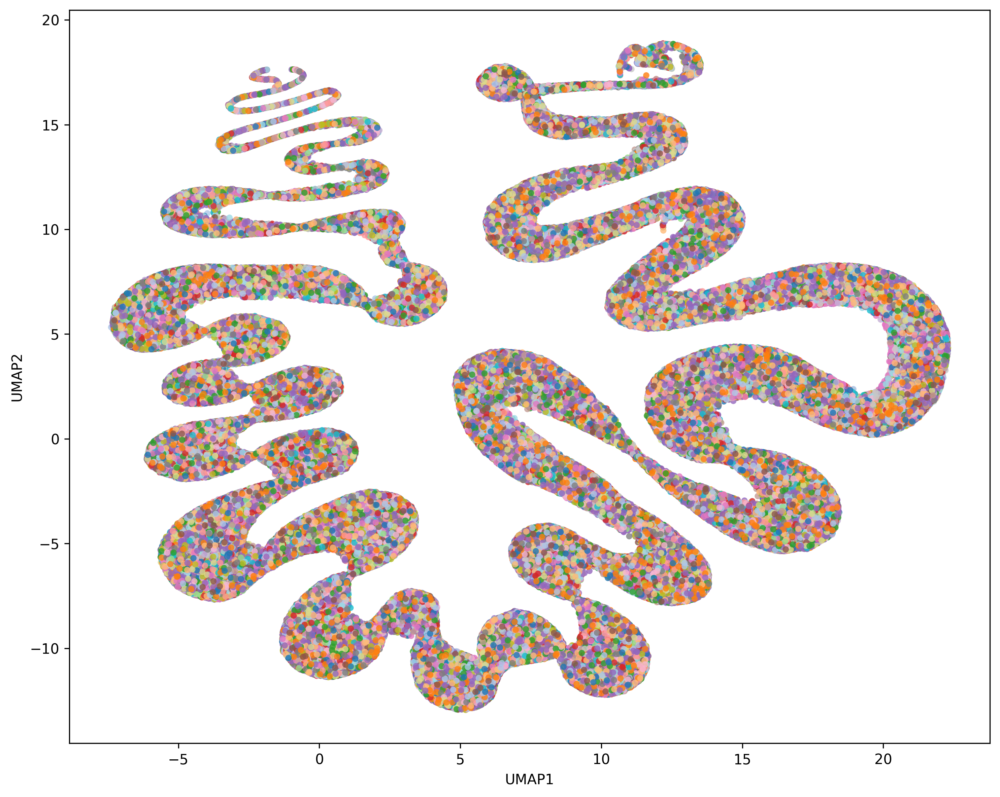

In [87]:
# Initialize UMAP
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1)

# Fit and transform the features
umap_embedding = umap_model.fit_transform(all_features)

# Turn into a DataFrame for easier plotting
umap_df = pd.DataFrame({
    'UMAP1': umap_embedding[:, 0],
    'UMAP2': umap_embedding[:, 1],
    'Drug': all_treatments
})

plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=umap_df,
    x='UMAP1', y='UMAP2',
    hue='Drug',
    palette='tab20',
    linewidth=0,
    s=20,
    alpha=0.8,
    legend=False
)

plt.tight_layout()
plt.show()


#### UMAP embedding with PCA

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
<ipython-input-62-75f54735c89e>:28: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)


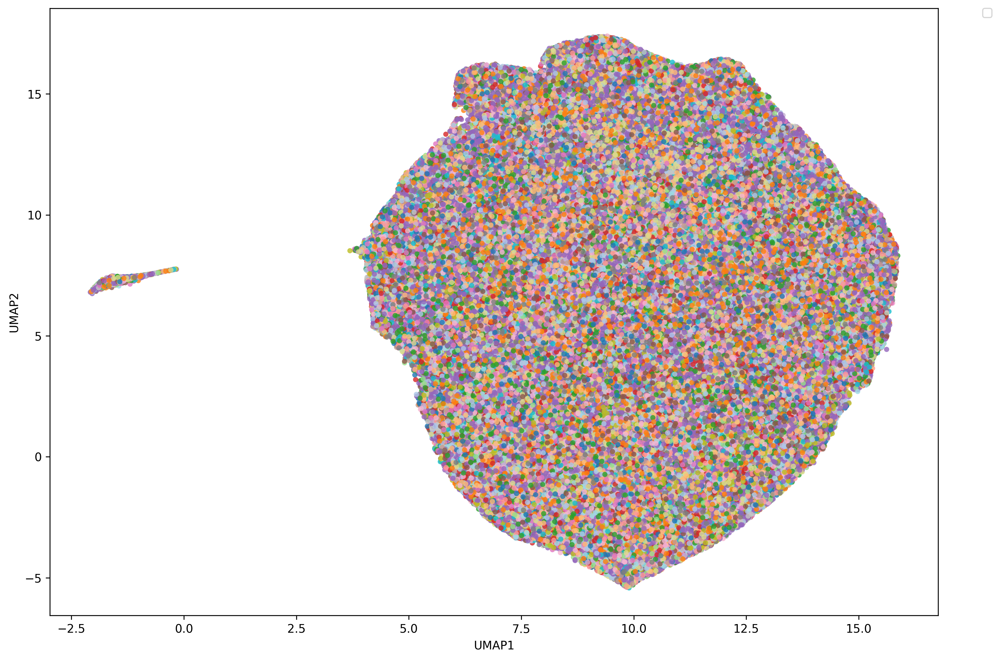

In [62]:
# X_top20 = features_no_dmso[top_20_mask]

# Initialize UMAP
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1)

# Fit and transform the features
umap_embedding = umap_model.fit_transform(features_pca)

# Turn into a DataFrame for easier plotting
umap_df = pd.DataFrame({
    'UMAP1': umap_embedding[:, 0],
    'UMAP2': umap_embedding[:, 1],
    'Drug': all_treatments
})

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=umap_df,
    x='UMAP1', y='UMAP2',
    hue='Drug',
    palette='tab20',
    linewidth=0,
    s=20,
    alpha=0.8,
    legend=False
)

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.tight_layout()
plt.show()

#### PCA on top 20 features EXCLUDING DMSO

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


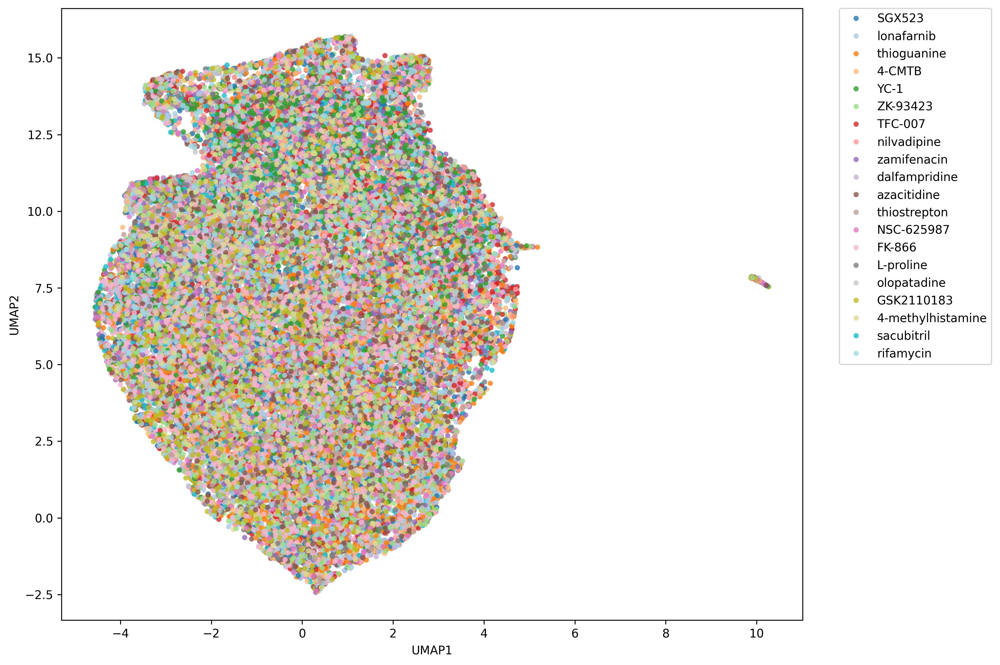

In [42]:
top_20_mask = np.isin(treatments_no_dmso, top_20_treatments.index)

X_top20 = features_no_dmso[top_20_mask]
y_top20 = treatments_no_dmso[top_20_mask]

pca = PCA(n_components=n_components)
pca20 = pca.fit_transform(X_top20)

# Initialize UMAP
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1)

# Fit and transform the features
umap_embedding = umap_model.fit_transform(pca20)

# Turn into a DataFrame for easier plotting
umap_df = pd.DataFrame({
    'UMAP1': umap_embedding[:, 0],
    'UMAP2': umap_embedding[:, 1],
    'Drug': y_top20
})

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=umap_df,
    x='UMAP1', y='UMAP2',
    hue='Drug',
    palette='tab20',
    linewidth=0,
    s=20,
    alpha=0.8,
    legend='full'
)

# plt.title("UMAP Projection of Morphological Features for the Top 20 Treatments with Most Cell Counts")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.tight_layout()
plt.show()